In [1]:
# Import libraries
import nilearn
import numpy as np                # core array type and mathematical functions
import matplotlib.pyplot as plt   # plotting
from nilearn import plotting      # brain network plotting
import bct as bct                 # brain connectivity toolbox - network analysis
import networkx as nx             # network construction and analysis


In [252]:
# Converting MATLAB file into Python for the "27_SCHZ_CTRL_dataset.mat" file, code provided by Frantisek Vasa

import h5py
import numpy as np

# load a .mat file and extract the data within

dataName = '/Users/ijisoo/Desktop/Assessment/27_SCHZ_CTRL_dataset.mat' # name of .mat file (including the path)
f = h5py.File(dataName)                                        # this loads the data

# Now the data needs to be accessed using keys.
# At each step we can list the contents to unravel the full file hierarchy

list(f.keys())  
# ['#refs#', '#subsystem#', 'SC_FC_Connectomes']                  

list(f['SC_FC_Connectomes'])
# ['FC_correlation','SC_ADC','SC_density','SC_gFA','SC_length_of_fibers','SC_number_of_fibers','demographics']

list(f['SC_FC_Connectomes/FC_correlation'])
# ['ctrl', 'schz']

list(f['SC_FC_Connectomes/FC_correlation/ctrl']) # 27 * the number of nodes 
# the five arrays
# [0] -> dimension 27 x 83 x 83
# [1] -> dimension 27 x 129 x 129
# [2] -> dimension 27 x 234 x 234
# [3] -> dimension 27 x 463 x 463
# [4] -> dimension 27 x 1015 x 1015

# load Functional Connectivity array for controls
ref_FC_c = f['SC_FC_Connectomes']['FC_correlation']['ctrl'][2][0] # the first index refers to the connectome resolution as listed above (NOTE also the addition of the extra [0] at the end)
arr_FC_c = np.array(f[ref_FC_c])
print(arr_FC_c.shape)

# now 'arr_FC_c' contains 27 matrices of 234 regions of interest for control participants

# load Functional Connectivity array for schz
ref_FC_s = f['SC_FC_Connectomes']['FC_correlation']['schz'][2][0]
arr_FC_s = np.array(f[ref_FC_s])
print(arr_FC_s.shape)

# now 'arr_FC_s' contains 27 matrices of 234 regions of interest for schizophrenia participants


(27, 234, 234)
(27, 234, 234)


In [3]:
# Check if there is any NaN values in the matrices
    
if np.any(np.isnan(arr_SC_c)) or np.any(np.isnan(arr_SC_s)):
    raise ValueError("Input matrices contain NaN values.")

    
if np.any(np.isnan(arr_FC_c)) or np.any(np.isnan(arr_FC_s)):
    raise ValueError("Input matrices contain NaN values.")

In [253]:
# Looking at Functional Connectivity defining basic network variables, to check

## Controls

    
nnode_c = arr_FC_c.shape[1]  # number of nodes
print(nnode_c)


triu_c = np.triu_indices(nnode_c, 1) # upper triangular part of the matrix

# total possible number of edges            
nedge_poss_c = int(nnode_c*(nnode_c-1)/2)
print(nedge_poss_c)


# existing number of edges
nedge_true_c = np.count_nonzero(arr_FC_c[0][triu_c])
print(nedge_true_c)

# edge density
edge_dens_c = nedge_true_c/nedge_poss_c
print(f'The edge density of this functional connectome is { round(100*edge_dens_c, 1) }%.')

# In[]:

for i in range(arr_FC_c.shape[0]):
   [nedge_poss_c]
   [nnode_c]
   [nedge_true_c]
   [edge_dens_c]

234
27261
27261
The edge density of this functional connectome is 100.0%.


In [254]:
## Schz group

nnode_s = arr_FC_s.shape[1]  # number of nodes
print(nnode_s)

triu_s = np.triu_indices(nnode_s, 1) # upper triangular part of the matrix

# total possible number of edges            
nedge_poss_s = int(nnode_s*(nnode_s-1)/2)
print(nedge_poss_s)


# existing number of edges
nedge_true_s = np.count_nonzero(arr_FC_s[0][triu_s])
print(nedge_true_s)

# edge density
edge_dens_s = nedge_true_s/nedge_poss_s
print(f'The edge density of this functional connectome is { round(100*edge_dens_s, 1) }%.')

# In[]:
for i in range(arr_FC_c.shape[0]):
       [nedge_poss_s]
       [nnode_s]
       [nedge_true_s]
       [edge_dens_s]

234
27261
27261
The edge density of this functional connectome is 100.0%.


Visualise Functional Connectivity in both groups

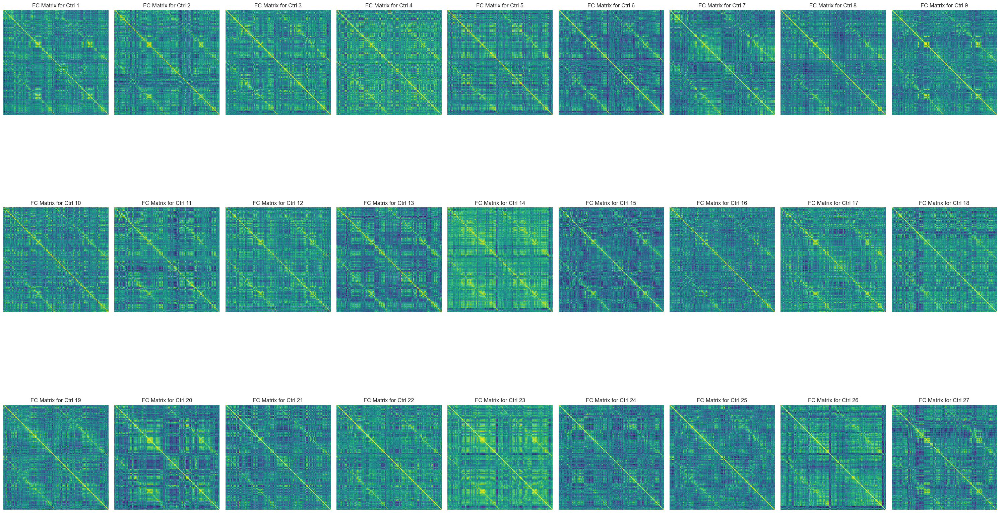

In [221]:
# for controls group

# Number of subjects
num_sub = arr_FC_c.shape[0]

# Set the number of columns for subplots
num_columns = 9
num_rows = (num_sub + num_columns - 1) // num_columns 

# Create subplots
fig, axes = plt.subplots(num_rows, num_columns, figsize = (30,20))

# Flatten the axes array if it's more than 1D
axes = axes.flatten()

# Loop through subjects and plot on subplots
for i in range(num_sub):
    axes[i].imshow(arr_FC_c[i], interpolation='nearest',cmap = 'viridis')
    axes[i].set_title(f'FC Matrix for Ctrl {i + 1}')
    axes[i].axis('off')  

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


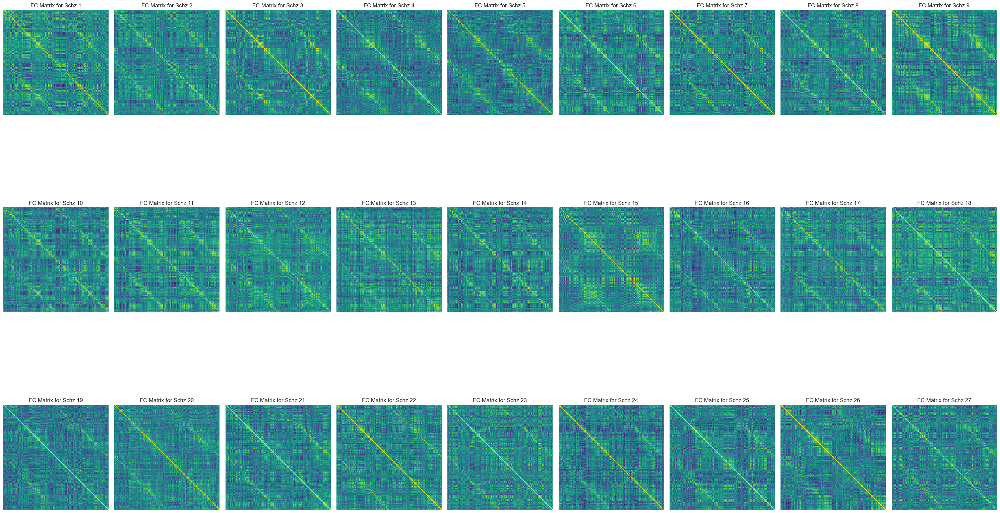

In [219]:
# Visualise functional connectivity 
# for Schz group


# Thresholded functional connectivity matrix
# for Schz

# Number of subjects
num_sub = arr_FC_s.shape[0]

# Set the number of columns for subplots
num_columns = 9
num_rows = (num_sub + num_columns - 1) // num_columns 

# Create subplots
fig, axes = plt.subplots(num_rows, num_columns, figsize = (30,20))

# Flatten the axes array if it's more than 1D
axes = axes.flatten()

# Loop through subjects and plot on subplots
for i in range(num_sub):
    axes[i].imshow(arr_FC_s[i], interpolation='nearest',cmap = 'viridis')
    axes[i].set_title(f'FC Matrix for Schz {i + 1}')
    axes[i].axis('off')  

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


In [10]:
# Thresholding using MST, function copied and pasted from mst_threshold_function.ipynb file 


def mst_threshold(W, dens):
    
    # Function to threshold weighted matrices, enforcing connectedness by 
    # setting the maximum spanning tree as a backbone to the network.
    # Works only with symmetric matrices. Ignores negative weights.
    
    ## Dependence: scipy
    
    ## Input 
    # W     weighted matrix
    # dens  density (in range [0,1])
    
    ## Output
    # A     thresholded matrix
    # MST   the maximum spanning tree
    
    # author: Petra Vertes
    # modified by Frantisek Vasa
    
    nnod = W.shape[0]   # N nodes
    W = (W + W.T) / 2   # force symmetrize matrix 
    # W[W < 0] = 0 # optional - set negative weights to 0
    W[np.arange(nnod), np.arange(nnod)] = 1 # set diagonal to 1
   
    # create MST (the MAXIMUM spanning tree of the network) using networkx
    G = nx.from_numpy_array(W)          # convert numpy array to networkx graph
    G_MST = nx.maximum_spanning_tree(G) # generate MST
    MST = nx.to_numpy_array(G_MST)      # convert back to numpy array
    
    # order W according to decreasing weights in the correlation matrix
    W_tr = np.triu(W, k=1)
    ind = np.where(np.triu(np.ones((nnod, nnod)), k=1))
    Wlist = W_tr[ind]
    IX = np.argsort(Wlist)[::-1]
    row = ind[0][IX]
    col = ind[1][IX]
    
    # store initial MST in the adjacency matrix A that defines the output network
    A = np.zeros((nnod, nnod))    
    A[MST.nonzero()] = W[MST.nonzero()]
        
    # grow the network according to weights in W matrix 
    t = 0 
    enum = nnod - 1 # counts total number of edges
    
    # add edges in correct order until all possible edges exist
    while enum < dens * nnod * (nnod - 1) / 2:
        
        # if edge wasn't initially included in MST    
        if A[row[t], col[t]] == 0:       
            
            # add edge
            A[row[t], col[t]] = W[row[t], col[t]]            
            A[col[t], row[t]] = W[col[t], row[t]]  
            
            # increment counters
            enum += 1    
        t += 1
        
    return A, MST

In [11]:
# Iterate over number of subjects to threshold the matrices with value of 0.2 for controls

num_sub = len(arr_FC_c)

# Create an empty list to store thresholded matrices
thresholded_matrices = []

# For loop to threshold each matrix
for i in range(num_sub):
    
    thresholded_output_ctrl, MST_output_ctrl = mst_threshold(arr_FC_c[i], 0.2) # thresholded output for controls
    
    # Append the thresholded matrix to the list
    thresholded_matrices.append(thresholded_output_ctrl)

# Convert the list of thresholded matrices to a NumPy array
thresholded_matrices_ctrl = np.array(thresholded_matrices)

# Check the shape
thresholded_matrices_ctrl.shape

(27, 234, 234)

In [12]:
# for schz

num_sub = len(arr_FC_s)

# Create an empty list to store thresholded matrices
thresholded_matrices = []

# For loop to threshold each matrix
for i in range(num_sub):
    
    thresholded_output_schz, MST_output_schz = mst_threshold(arr_FC_s[i], 0.2) # thresholded output for controls
    
    # Append the thresholded matrix to the list
    thresholded_matrices.append(thresholded_output_schz)

# Convert the list of thresholded matrices to a NumPy array
thresholded_matrices_schz = np.array(thresholded_matrices)


# Check the shape
thresholded_matrices_schz.shape

(27, 234, 234)

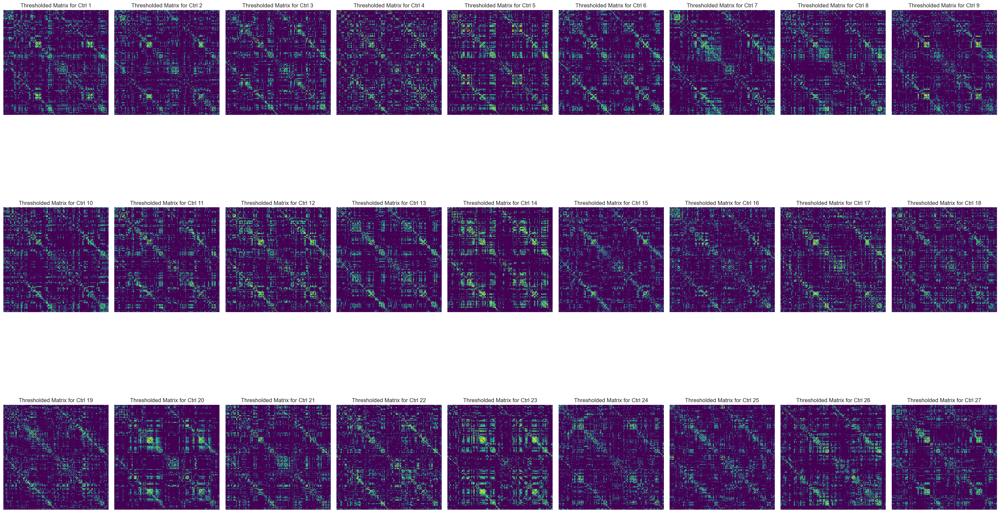

In [214]:
# Thresholded functional connectivity matrix
# for controls


# Number of subjects
num_sub = thresholded_matrices_ctrl.shape[0]

# Set the number of columns for subplots 
num_columns = 9
num_rows = (num_sub + num_columns - 1) // num_columns  

# Create subplots
fig, axes = plt.subplots(num_rows, num_columns, figsize = (30,20))

# Flatten the axes array if it's more than 1D
axes = axes.flatten()

# Loop through subjects and plot on subplots
for i in range(num_sub):
    axes[i].imshow(thresholded_matrices_ctrl[i], interpolation='nearest', cmap = 'viridis' )
    axes[i].set_title(f'Thresholded Matrix for Ctrl {i + 1}')
    axes[i].axis('off') 

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


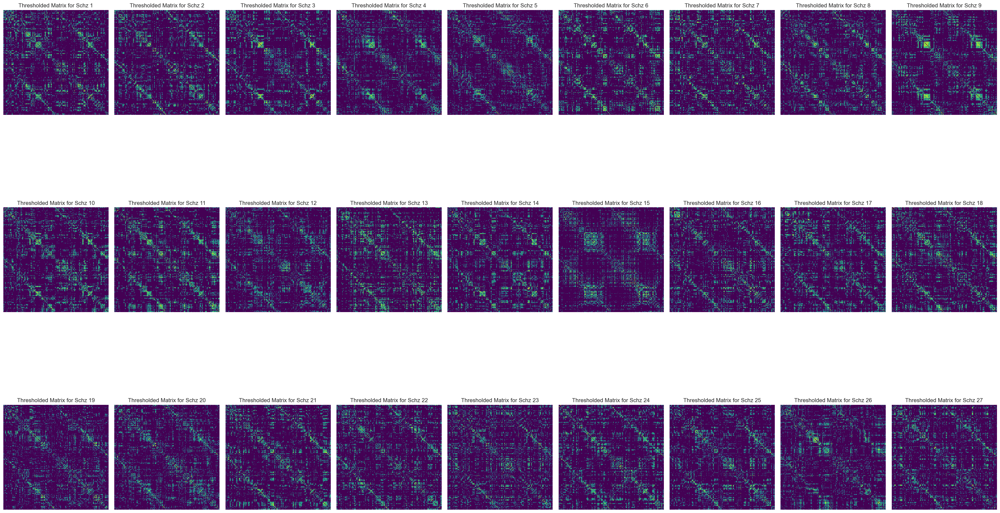

In [215]:
# Thresholded functional connectivity matrix
# for Schz

# Number of subjects
num_sub = thresholded_matrices_schz.shape[0]

# Set the number of columns for subplots 
num_columns = 9
num_rows = (num_sub + num_columns - 1) // num_columns  
# Create subplots
fig, axes = plt.subplots(num_rows, num_columns, figsize = (30,20))

# Flatten the axes array if it's more than 1D
axes = axes.flatten()

# Loop through subjects and plot on subplots
for i in range(num_sub):
    axes[i].imshow(thresholded_matrices_schz[i], interpolation='nearest', cmap = 'viridis')
    axes[i].set_title(f'Thresholded Matrix for Schz {i + 1}')
    axes[i].axis('off')  

# Adjust layout for better spacing
plt.tight_layout()
plt.show()

 Now we can calculate graph theoretical measures using thresholded matrices

In [15]:
# Eigenvector Centrality

# for controls

# Number of subjects
num_sub = len(thresholded_matrices_ctrl)

# Create an empty list to store eigenvector centralities
eigenvector_centralities_ctrl = []

# For loop to calculate eigenvector centrality for each matrix
for i in range(num_sub):
    # Calculate eigenvector centrality for the current matrix
    centrality = bct.eigenvector_centrality_und(thresholded_matrices_ctrl[i])
    
    # Append the centrality values to the list
    eigenvector_centralities_ctrl.append(centrality)

# Convert the list of centralities to a NumPy array
eigenvector_centralities_ctrl = np.array(eigenvector_centralities_ctrl)

eigenvector_centralities_ctrl.shape

(27, 234)

In [16]:
# for schz

# Number of subjects
num_sub = len(thresholded_matrices_schz)

# Create an empty list to store eigenvector centralities
eigenvector_centralities_schz = []

# For loop to calculate eigenvector centrality for each matrix
for i in range(num_sub):
    # Calculate eigenvector centrality for the current matrix
    centrality = bct.eigenvector_centrality_und(thresholded_matrices_schz[i])
    
    # Append the centrality values to the list
    eigenvector_centralities_schz.append(centrality)

# Convert the list of centralities to a NumPy array
eigenvector_centralities_schz = np.array(eigenvector_centralities_schz)


In [17]:
# Load the coordinates from https://github.com/jvohryzek/bert4lausanne2008

coord = plotting.find_parcellation_cut_coords(labels_img= 'ROI_scale125.nii')

In [18]:
coord.shape # check if it's the right one

(234, 3)

In [19]:
# Apply linear transformations to coordinates for better visualisation

vector_shift = [-3, -20, 3]
rescale = 1.06

coord_new = (coord+vector_shift)*rescale


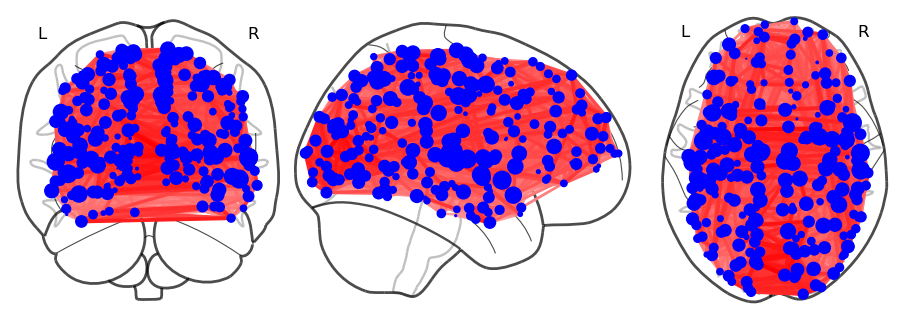

In [20]:
# 2D plot, with node sizes scaled according to eigenvector centrality for the first subject in control group for example


f = plt.figure(figsize=(9, 3))                    # set-up figure
plotting.plot_connectome(thresholded_matrices_ctrl[0],   # connectome
                         node_coords=coord_new,   # node coordinates
                         node_color='blue',      # node colors (here, uniform)
                         node_size=1e3*eigenvector_centralities_ctrl[0], # node sizes scaled according to eigenvector centrality
                         figure=f);               # figure handle (set-up above)


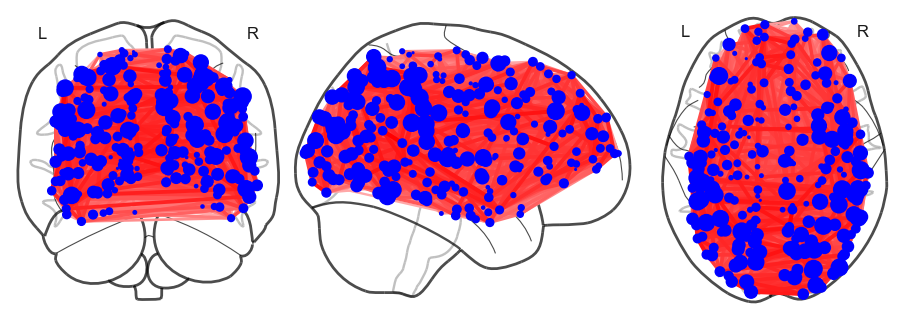

In [119]:
# 2D plot, with node sizes scaled according to eigenvector centrality for the first subject in schz group for example

f2 = plt.figure(figsize=(9, 3))                    # set-up figure
plotting.plot_connectome(thresholded_matrices_schz[0],   # connectome
                         node_coords=coord_new,   # node coordinates
                         node_color='blue',      # node colors (here, uniform)
                         node_size=1e3*eigenvector_centralities_schz[0], # node sizes scaled according to eigenvector centrality
                         figure=f2);               # figure handle (set-up above)


In [222]:
# 3D plot for for subject in ctrl group

view = plotting.view_connectome(thresholded_matrices_ctrl[0],              # connectome
                         node_coords= coord, # node coordinates
                         node_size= 300*eigenvector_centralities_ctrl[0])    # node sizes scaled by 300 
view                                            # view the network


In [223]:
# 3D plot for for subject in schz group

view_schz = plotting.view_connectome(thresholded_matrices_schz[0],              # connectome
                         node_coords= coord, # node coordinates
                         node_size= 300*eigenvector_centralities_ctrl[0])    # node sizes scaled by 300 
view_schz                                            # view the network


Calculating two versions of topological distance, binary and weighted

In [23]:
# For binary topological distance, create a binarised matrix first

#Controls
Cbinarised_ctrl = np.copy(thresholded_matrices_ctrl) # first create a copy of the matrix 
Cbinarised_ctrl[thresholded_matrices_ctrl>0] = 1     # binarise existing edges

#Schz
Cbinarised_schz = np.copy(thresholded_matrices_schz)
Cbinarised_schz[thresholded_matrices_schz>0] = 1  

In [25]:
# Binary topological distance for control
                            
# Number of subjects
num_sub = len(Cbinarised_ctrl)

# Create an empty list to store binary distance
Dbin_ctrl = []

# For loop to calculate binary distance for each matrix
for i in range(num_sub):
    # Calculate binary distance for the current matrix
    Dbin_c = bct.distance_bin(Cbinarised_ctrl[i])
    # Append the distances into list
    Dbin_ctrl.append(Dbin_c)
    
# Convert the list of distances to a NumPy array
Dbin_ctrl = np.array(Dbin_ctrl)

In [27]:
Dbin_ctrl.shape

(27, 234, 234)

In [225]:
# Weighted topological distance for control

# Number of subjects
num_sub = len(thresholded_matrices_ctrl)

# Create an empty list to store binary distance
Dwei_ctrl = []

# For loop to calculate weighted distance for each matrix
for i in range(num_sub):
    # Calculate weighted distance for the current matrix
    Dwei_c, Dwei_n = bct.distance_wei(thresholded_matrices_ctrl[i])
    # Append the distances into list
    Dwei_ctrl.append(Dwei_c)
    
# Convert the list of distances to a NumPy array
Dwei_ctrl = np.array(Dwei_ctrl)
Dwei_ctrl.shape

(27, 234, 234)

In [29]:
# Binary topological distance for Schz

# Number of subjects
num_sub = len(Cbinarised_schz)

# Create an empty list to store binary distance
Dbin_schz = []

# For loop to calculate binary distance for each matrix
for i in range(num_sub):
    # Calculate binary distance for the current matrix
    Dbin_s = bct.distance_bin(Cbinarised_schz[i])
    # Append the distances into list
    Dbin_schz.append(Dbin_s)
    
# Convert the list of distances to a NumPy array
Dbin_schz = np.array(Dbin_schz)

Dbin_schz.shape

(27, 234, 234)

In [226]:
# Weighted topological distance for Schz

# Number of subjects
num_sub = len(thresholded_matrices_schz)

# Create an empty list to store weighted distance
Dwei_schz = []

# For loop to calculate weighted distance for each matrix
for i in range(num_sub):
    # Calculate weighted distance for the current matrix
    Dwei_s, Dwei_n = bct.distance_wei(thresholded_matrices_schz[i])
    # Append the distances into list
    Dwei_schz.append(Dwei_s)
    
# Convert the list of distances to a NumPy array
Dwei_schz = np.array(Dwei_schz)

Dwei_schz.shape

(27, 234, 234)

Calculate measure of network integration: characteristic path length

In [64]:
# Binary Characteristic Path lengths
#  Controls and Schz
              
# Number of subjects
num_sub_ctrl = len(Dbin_ctrl)
num_sub_schz = len(Dbin_schz)

# Create list to store values
ctrl_bin_pl = []
schz_bin_pl = []

# For loop to calculate binary path length for each matrices
for i in range(num_sub_ctrl):
    
    # Calculate binary path length for the connectome and report for each participant
    pl_Dbin_c = bct.charpath(Dbin_ctrl[i])[0]
    # Append to a list
    ctrl_bin_pl.append(pl_Dbin_c)
    # Print the values below
    print(f'Binary Characteristic Path Length for Ctrl {i + 1} is { round(pl_Dbin_c, 2)}')
    
# Convert the list into array
ctrl_bin_pl = np.array(ctrl_bin_pl)    

# Schz
for i in range(num_sub_schz):
    # Calculate binary path length for the connectome and report for each participant
    pl_Dbin_s = bct.charpath(Dbin_schz[i])[0]
    # Append to a list
    schz_bin_pl.append(pl_Dbin_s)
    # Print the values below
    print(f'Binary Characteristic Path Length for Schz {i + 1} is { round(pl_Dbin_s, 2)}')

# Convert the list into array
schz_bin_pl = np.array(schz_bin_pl)   

Binary Characteristic Path Length for Ctrl 1 is 1.94
Binary Characteristic Path Length for Ctrl 2 is 2.03
Binary Characteristic Path Length for Ctrl 3 is 2.01
Binary Characteristic Path Length for Ctrl 4 is 2.07
Binary Characteristic Path Length for Ctrl 5 is 2.05
Binary Characteristic Path Length for Ctrl 6 is 2.02
Binary Characteristic Path Length for Ctrl 7 is 1.99
Binary Characteristic Path Length for Ctrl 8 is 2.05
Binary Characteristic Path Length for Ctrl 9 is 1.94
Binary Characteristic Path Length for Ctrl 10 is 2.0
Binary Characteristic Path Length for Ctrl 11 is 2.06
Binary Characteristic Path Length for Ctrl 12 is 2.01
Binary Characteristic Path Length for Ctrl 13 is 2.03
Binary Characteristic Path Length for Ctrl 14 is 2.13
Binary Characteristic Path Length for Ctrl 15 is 1.92
Binary Characteristic Path Length for Ctrl 16 is 1.91
Binary Characteristic Path Length for Ctrl 17 is 1.98
Binary Characteristic Path Length for Ctrl 18 is 2.02
Binary Characteristic Path Length for 

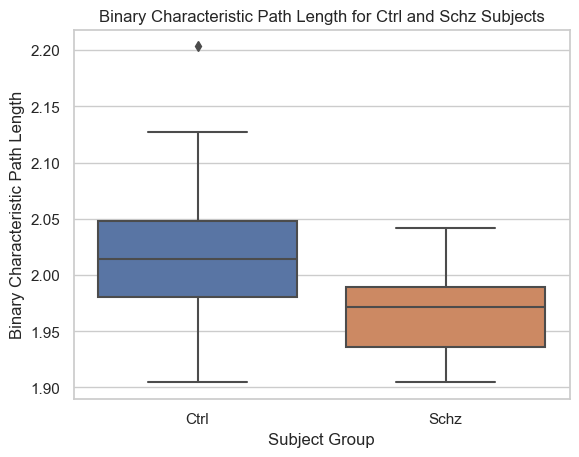

In [239]:
# Visualise the data

ctrl_data = ctrl_bin_pl   
schz_data = schz_bin_pl

df = pd.DataFrame({'Ctrl': ctrl_data, 'Schz': schz_data})

# Plotting a box plot
plt.figure()
sns.boxplot(data=df)
plt.title('Binary Characteristic Path Length for Ctrl and Schz Subjects')
plt.xlabel('Subject Group')
plt.ylabel('Binary Characteristic Path Length')
plt.show()

In [227]:
# Weighted Characteristic Path lengths
#  Controls and Schz

# Number of subjects
num_sub_ctrl = len(Dwei_ctrl)
num_sub_schz = len(Dwei_schz)

# Create list to store values
ctrl_wei_pl = []


# For loop to calculate weighted path length for each matrices
for i in range(num_sub_ctrl):
    
    # Calculate weighted path length for the connectome and report for each participant
    pl_Dwei_c = bct.charpath(Dwei_ctrl[i])[0]
    # Append to a list
    ctrl_wei_pl.append(pl_Dwei_c)
    # Print the values below
    print(f'Weighted Characteristic Path Length for Ctrl {i + 1} is { round(pl_Dwei_c, 2)}')
    
# Convert the list into array
ctrl_wei_pl = np.array(ctrl_wei_pl)   


schz_wei_pl = []
# Schz
for i in range(num_sub_schz):
    # Calculate weighted path length for the connectome and report for each participant
    pl_Dwei_s = bct.charpath(Dwei_schz[i])[0]
    # Append to a list
    schz_wei_pl.append(pl_Dwei_s)
    # Print the values below
    print(f'Weighted Characteristic Path Length for Schz {i + 1} is { round(pl_Dwei_s, 2)}')

# Convert the list into array
schz_wei_pl = np.array(schz_wei_pl)


Weighted Characteristic Path Length for Ctrl 1 is 0.78
Weighted Characteristic Path Length for Ctrl 2 is 0.78
Weighted Characteristic Path Length for Ctrl 3 is 0.77
Weighted Characteristic Path Length for Ctrl 4 is 0.89
Weighted Characteristic Path Length for Ctrl 5 is 0.88
Weighted Characteristic Path Length for Ctrl 6 is 0.77
Weighted Characteristic Path Length for Ctrl 7 is 0.76
Weighted Characteristic Path Length for Ctrl 8 is 0.82
Weighted Characteristic Path Length for Ctrl 9 is 0.62
Weighted Characteristic Path Length for Ctrl 10 is 0.78
Weighted Characteristic Path Length for Ctrl 11 is 0.75
Weighted Characteristic Path Length for Ctrl 12 is 0.92
Weighted Characteristic Path Length for Ctrl 13 is 0.76
Weighted Characteristic Path Length for Ctrl 14 is 1.07
Weighted Characteristic Path Length for Ctrl 15 is 0.54
Weighted Characteristic Path Length for Ctrl 16 is 0.63
Weighted Characteristic Path Length for Ctrl 17 is 0.78
Weighted Characteristic Path Length for Ctrl 18 is 0.78
W

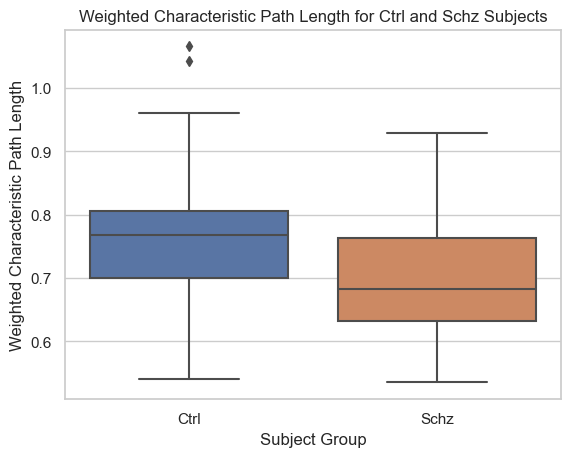

In [240]:
# Visualise the data

ctrl_data = ctrl_wei_pl   
schz_data = schz_wei_pl

df = pd.DataFrame({'Ctrl': ctrl_data, 'Schz': schz_data})

# Plotting a box plot
plt.figure()
sns.boxplot(data=df)
plt.title('Weighted Characteristic Path Length for Ctrl and Schz Subjects')
plt.xlabel('Subject Group')
plt.ylabel('Weighted Characteristic Path Length')
plt.show()

Calculate measure of network segregation: clustering coefficient

In [199]:
# For Binary

# Number of subjects
num_sub_ctrl = len(Cbinarised_ctrl)

# Create an empty list to store clustering coefficients
ccoeff_bin_ctrl = []


# For loop to calculate local binary clustering coefficient for each ctrl matrix
for i in range(num_sub_ctrl):
    # Calculate local clustering coefficient for each subject
    node_clust_bin_c = bct.clustering_coef_bu(Cbinarised_ctrl[i])
    avg_clust_bin_c = np.mean(node_clust_bin_c)
    ccoeff_bin_ctrl.append(avg_clust_bin_c)
print(ccoeff_bin_ctrl)
len(ccoeff_bin_ctrl)




[0.555066981486313, 0.544382610493644, 0.5603797802715577, 0.5840205279469974, 0.5808509406461064, 0.5590964881792283, 0.5494474204475287, 0.5658080430171827, 0.5212809658074287, 0.566739168250746, 0.5893771257531261, 0.586805432669456, 0.5615125663218482, 0.5852881080853342, 0.5099601541209415, 0.4949054663897655, 0.5354590751095833, 0.5715322396899967, 0.5264124101892232, 0.5851647360683844, 0.559599744283468, 0.5279567163138829, 0.5861622640272162, 0.5204633796406816, 0.5188781365945258, 0.5694072798473678, 0.5574841286010401]


27

In [200]:
# Schz group
# Number of subjects
num_sub_schz = len(Cbinarised_schz)

# Create an empty list to store clustering coefficients
ccoeff_bin_schz = []


# For loop to calculate local binary clustering coefficient for each ctrl matrix
for i in range(num_sub_schz):
    # Calculate local clustering coefficient for each subject
    node_clust_bin_s = bct.clustering_coef_bu(Cbinarised_schz[i])
    avg_clust_bin_s = np.mean(node_clust_bin_s)
    ccoeff_bin_schz.append(avg_clust_bin_s)


print(ccoeff_bin_schz)
len(ccoeff_bin_schz)

[0.5556472904636022, 0.527594046670256, 0.5485521223573634, 0.48649528446160717, 0.48007394297113465, 0.5428409383888394, 0.528194892607137, 0.5017386396379117, 0.5385959597164087, 0.5374324392394653, 0.5498913858266109, 0.5196058471268934, 0.556490433850031, 0.5591281216753855, 0.5650981323706027, 0.5163263782357758, 0.5469447662330422, 0.5286522540149146, 0.4700404624054144, 0.4788075709604944, 0.5226264276045802, 0.526130118057147, 0.5251115321668954, 0.5446499016706362, 0.5406820956001677, 0.4914068736073633, 0.5303291346821789]


27

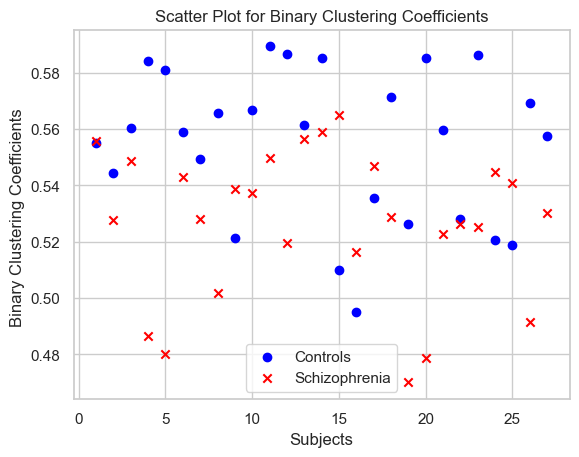

In [249]:
# Visualise binary clustering coefficient using scatterplot

# Create indices for each data point
indices1 = range(1, len(ccoeff_bin_ctrl) + 1)
indices2 = range(1, len(ccoeff_bin_schz) + 1)

# Plotting the scatter plot for both datasets
plt.figure()
plt.scatter(indices1, ccoeff_bin_ctrl, color='blue', marker='o', label='Controls')
plt.scatter(indices2, ccoeff_bin_schz, color='red', marker='x', label='Schizophrenia')

plt.title('Scatter Plot for Binary Clustering Coefficients')
plt.xlabel('Subjects')
plt.ylabel('Binary Clustering Coefficients ')
plt.legend()  # Add legend to distinguish between datasets
plt.show()

In [209]:
# Weighted for control

# Create an empty list to store weighted clustering coefficients
ccoeff_wei_ctrl = []

for i in range(num_sub_ctrl):
    # Calculate local clustering coefficient for each subject
    node_clust_wei_c = bct.clustering_coef_wu(thresholded_matrices_ctrl[i])
    avg_clust_wei_c = np.mean(node_clust_wei_c)
    ccoeff_wei_ctrl.append(avg_clust_wei_c)

print(ccoeff_wei_ctrl,"The global clustering coefficient is",avg_clust_wei_c )
len(ccoeff_wei_ctrl)

[0.2781028921556562, 0.26170070842488236, 0.27510358112873406, 0.31430018380020275, 0.3086641949322075, 0.2752983331185785, 0.26849942424595047, 0.28089280567683655, 0.23281255663204828, 0.2808862129529527, 0.2810912802156836, 0.3194761010117746, 0.2738241493719239, 0.3431909279309227, 0.20854663582299882, 0.2137503644454028, 0.2695133609554182, 0.2789271614638681, 0.2342182930750918, 0.2857178747888016, 0.2510832792876892, 0.2571834406845087, 0.3424439446013805, 0.22314464906968676, 0.21554867398965313, 0.29800994425083965, 0.2657038528546296] The global clustering coefficient is 0.2657038528546296


27

In [201]:
# Weighted for schz
# Create an empty list to store weighted clustering coefficients
ccoeff_wei_schz = []

for i in range(num_sub_schz):
    # Calculate local clustering coefficient for each subject
    node_clust_wei_s = bct.clustering_coef_wu(thresholded_matrices_schz[i])
    avg_clust_wei_s = np.mean(node_clust_wei_s)
    ccoeff_wei_schz.append(avg_clust_wei_s)

print(ccoeff_wei_schz)
len(ccoeff_wei_schz)

[0.27045677921894395, 0.2317427107307946, 0.24156276817717837, 0.2058124162798965, 0.18773562888237347, 0.2691402009862042, 0.23452876316204646, 0.2178997283260296, 0.2632967817625769, 0.26958346752122625, 0.27839525406172605, 0.230105814188738, 0.3045897046042106, 0.2599772357392749, 0.25677907211009904, 0.22189265998434965, 0.2642128829404403, 0.2709053882676682, 0.17957742959287024, 0.20000489558856083, 0.2568541974802783, 0.23540071759319475, 0.23496599123231554, 0.25288343607952096, 0.23281182187331087, 0.2121732890725791, 0.22475482873119448]


27

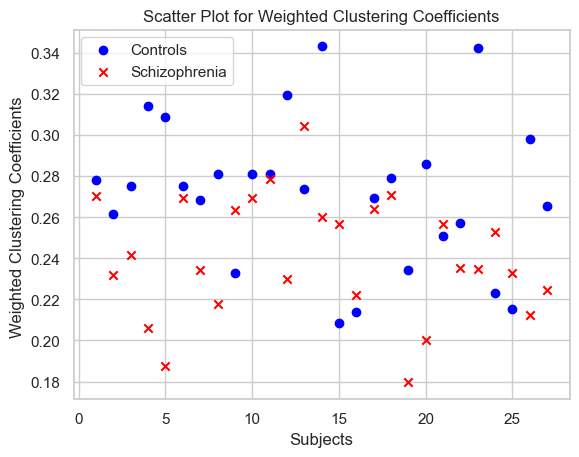

In [248]:
# Visualise weighted clustering coefficient using scatterplot

# Create indices for each data point
indices1 = range(1, len(ccoeff_wei_ctrl) + 1)
indices2 = range(1, len(ccoeff_wei_schz) + 1)

# Plotting the scatter plot for both datasets
plt.figure()
plt.scatter(indices1, ccoeff_wei_ctrl, color='blue', marker='o', label='Controls')
plt.scatter(indices2, ccoeff_wei_schz, color='red', marker='x', label='Schizophrenia')

plt.title('Scatter Plot for Weighted Clustering Coefficients')
plt.xlabel('Subjects')
plt.ylabel('Weighted Clustering Coefficients ')
plt.legend()  
plt.show()

In [207]:
# Identifying node with the highest binary clustering coefficient

max_clust_ctrl = np.where(node_clust_bin_c == np.max(node_clust_bin_c)) # identify index of node with maximum clustering
max_clust_schz =np.where(node_clust_bin_s == np.max(node_clust_bin_s)) 

print(max_clust_ctrl, "and", max_clust_schz)

(array([200]),) and (array([199]),)


Statistical Analysis (t-tests) for each measures, correcting for multiple comparisons

In [232]:
from scipy import stats

# Calculate the t-test for eigenvector centrality

# Generate indices to identify controls and schz group in the data array
ind_ctrl = np.where(eigenvector_centralities_ctrl)[0] 
ind_schz = np.where(eigenvector_centralities_schz)[0]

ec_ctrl = np.where(eigenvector_centralities_ctrl)[1]
ec_schz = np.where(eigenvector_centralities_schz)[1]

t_stat_ec, p_val_ec = stats.ttest_ind(ec_ctrl[ind_ctrl], ec_schz[ind_schz])

# Report the values
print(f'The t-statistic for the difference in eigenvector centrality between healthy controls and patients with schizophrenia '
      f'is t = {round(t_stat_ec,2)}. The corresponding p-value is p = {p_val_ec}.')

# Correct for multiple comparisons using FDR method
stats.false_discovery_control(p_val_ec)


The t-statistic for the difference in eigenvector centrality between healthy controls and patients with schizophrenia is t = 0.0. The corresponding p-value is p = 1.0.


1.0

In [233]:
# Generate indices to identify controls and schz group in the data array
ind_ctrl = np.where(Dbin_ctrl)[0] 
ind_schz = np.where(Dbin_schz)[0]

# Calculate the t-test for binary path lengths
t_stat_bpl, p_val_bpl = stats.ttest_ind(ctrl_bin_pl[ind_ctrl], schz_bin_pl[ind_schz])

# Report the values
print(f'The t-statistic for the difference in binary characteristic path length between healthy controls and patients with schizophrenia '
      f'is t = {round(t_stat,2)}. The corresponding p-value is p = {p_val_bpl}.')

# Correct for multiple comparisons using FDR method
stats.false_discovery_control(p_val)

The t-statistic for the difference in binary characteristic path length between healthy controls and patients with schizophrenia is t = 792.69. The corresponding p-value is p = 0.0.


0.0

In [234]:
# Calculate the t-test for weighted path lengths
t_stat_wpl, p_val_wpl = stats.ttest_ind(ctrl_wei_pl[ind_ctrl], schz_wei_pl[ind_schz])

# Report the values
print(f'The t-statistic for the difference in weighted characteristic path length between healthy controls and patients with schizophrenia '
      f'is t = {round(t_stat_wpl,2)}. The corresponding p-value is p = {p_val_wpl}.')

# Correct for multiple comparisons using FDR method
stats.false_discovery_control(p_val_wpl)

The t-statistic for the difference in weighted characteristic path length between healthy controls and patients with schizophrenia is t = 620.65. The corresponding p-value is p = 0.0.


0.0

In [250]:
# Calculate the t-test for binary clustering coefficients

# Generate indices to identify controls and schz group in the data array
ind_ctrl = np.where(Cbinarised_ctrl)[0] 
ind_schz = np.where(Cbinarised_schz)[0]

t_stat_cc, p_val_cc = stats.ttest_ind(node_clust_bin_c[ind_ctrl], node_clust_bin_s[ind_schz])

# Report the values
print(f'The t-statistic for the difference in binary clustering coefficient between healthy controls and patients with schizophrenia '
      f'is t = {round(t_stat_cc,2)}. The corresponding p-value is p = {p_val_cc}.')

# Correct for multiple comparisons using FDR method
stats.false_discovery_control(p_val_cc)


The t-statistic for the difference in binary clustering coefficient between healthy controls and patients with schizophrenia is t = -131.25. The corresponding p-value is p = 0.0.


0.0

In [251]:
# Calculate the t-test for weighted clustering coefficients

# Generate indices to identify controls and schz group in the data array
ind_ctrl = np.where(thresholded_matrices_ctrl)[0] 
ind_schz = np.where(thresholded_matrices_schz)[0]

t_stat_cc, p_val_cc = stats.ttest_ind(node_clust_wei_c[ind_ctrl], node_clust_wei_s[ind_schz])

# Report the values
print(f'The t-statistic for the difference in weighted clustering coefficient between healthy controls and patients with schizophrenia '
      f'is t = {round(t_stat_cc,2)}. The corresponding p-value is p = {p_val_cc}.')

# Correct for multiple comparisons using FDR method
stats.false_discovery_control(p_val_cc)


The t-statistic for the difference in weighted clustering coefficient between healthy controls and patients with schizophrenia is t = -50.7. The corresponding p-value is p = 0.0.


0.0